# Deep Learning Assignment

## Configuration

In [ ]:
import os
import keras
import cv2
import tarfile
import numpy as np
import tensorflow as tf

!pip install imagehash
import imagehash

from urllib import request
from google.colab.patches import cv2_imshow

from google.colab import drive
drive.mount(mountpoint='/content/drive', force_remount=False)

from PIL import Image
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPool2D , Flatten
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import EarlyStopping
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from matplotlib import pyplot as plt

base_path = "/content/drive/My Drive/DATA & AI 6/"
vgg_face_dataset_url = "http://www.robots.ox.ac.uk/~vgg/data/vgg_face/vgg_face_dataset.tar.gz"
trained_haarcascade_url = "https://raw.githubusercontent.com/opencv/opencv/master/data/haarcascades/haarcascade_frontalface_default.xml"

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 296 kB 14.3 MB/s 
Mounted at /content/drive


## Creating a VGG Face directory

In order to build our dataset, we will be using the VGG Face Dataset.  

We will first download the tar.gz archive file and then extract it into our Google Drive directory of choice.

In [ ]:
if not os.path.isdir(base_path):
  os.makedirs(base_path)


with request.urlopen(vgg_face_dataset_url) as r, open(os.path.join(base_path, "vgg_face_dataset.tar.gz"), 'wb') as f:
  f.write(r.read())

with tarfile.open(os.path.join(base_path, "vgg_face_dataset.tar.gz")) as f:
  f.extractall(os.path.join(base_path))


with request.urlopen(trained_haarcascade_url) as r, open(os.path.join(base_path, "haarcascade_frontalface_default.xml"), 'wb') as f:
    f.write(r.read())

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Collecting the neccessary images

Once the previous step is completed, the next step is to choose the actors for our training and testing datasets.  

We will do this by looping through the directory and viewing the available files.

In [ ]:
text_files = []

for filename in os.listdir(base_path + 'vgg_face_dataset/files'):
    if filename.endswith(".txt"): 
        text_files.append(filename)

print(len(text_files))

2622


The folder contains 2622 actors that we can choose from.  

Now it's up to us to choose which ones.

In [ ]:
text_files.sort()

print(*text_files, sep = '\n')

A.J._Buckley.txt
A.R._Rahman.txt
A_P_J_Abdul_Kalam.txt
Aamir_Khan.txt
Aaron_Staton.txt
Aaron_Tveit.txt
Aaron_Yoo.txt
Abbie_Cornish.txt
Abel_Ferrara.txt
Abigail_Breslin.txt
Abigail_Klein.txt
Abigail_Spencer.txt
Abraham_Benrubi.txt
Adam_Baldwin.txt
Adam_Beach.txt
Adam_Brody.txt
Adam_Buxton.txt
Adam_Copeland.txt
Adam_Driver.txt
Adam_G._Sevani.txt
Adam_Garcia.txt
Adam_Godley.txt
Adam_Goldberg.txt
Adam_Gregory.txt
Adam_Hicks.txt
Adam_Lambert.txt
Adam_Levine.txt
Adam_Rodriguez.txt
Adelaide_Clemens.txt
Adelaide_Kane.txt
Adina_Porter.txt
Aditya_Roy_Kapoor.txt
Adrian_Grenier.txt
Adrian_Paul.txt
Adriana_Barraza.txt
Adrianne_Curry.txt
Adrianne_Palicki.txt
Adrienne_Barbeau.txt
Agyness_Deyn.txt
Aida_Turturro.txt
Aidan_Gillen.txt
Aidan_Turner.txt
Ajay_Devgn.txt
Akshay_Kumar.txt
Alain_Delon.txt
Alan_Alda.txt
Alan_Cumming.txt
Alan_Dale.txt
Alan_Ladd.txt
Alan_Rickman.txt
Alan_Tudyk.txt
Alba_Rohrwacher.txt
Aldis_Hodge.txt
Alessandra_Torresani.txt
Alex_Borstein.txt
Alex_Kingston.txt
Alex_Newell.txt
Alex_

Based on the assignment, we have to choose 4 actors in total.  

- Person A
- Person B
- Person C
- Person D

The criteria:  
- Person A has to be similar to Person C.
- Person B has to be similar to Person D.

### My choice

Since I myself have bad memory and can't think of any actors, I make my decision based on a google search for similar actors.

#### Person A and Person C

Zoey Deschanel and Katy Perry  

![Person B and Person D](https://wl-brightside.cf.tsp.li/resize/728x/jpg/370/8ed/a5bf445d8f9b73247a4463acf1.jpg)

Charecteristics:
- Female
- Long dark hair
- Similar face structure

#### Person B and Person D

Ben Stiller and B.J. Novak 

![Person A and Person C](https://drive.google.com/uc?export=view&id=1jNibb_DWd4TXHF7cNEQzgHZkCoXIoQp_)

Charecteristics:
- Male
- Short dark hair
- Similar face structure

## Collecting the images

![image_specs](https://drive.google.com/uc?export=view&id=1PgdJrnxX9VrnAHe_vDXPGSKhDU0BB36Y)

The first thing I will do, is specify some variables, such as:
- Subjects
- Number of subjects (for the loop)
- Number of images per subject

Since some images could be inadequate for our training model, I will collect more than is neccessary so that later, I could filter out the bad samples.

In [ ]:
all_subjects = ['B.J._Novak', 'Ben_Stiller', 'Zooey_Deschanel', 'Katy_Perry']

number_of_subjects = 4

number_of_images_per_subject = 50

B.J._Novak


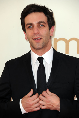

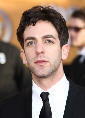

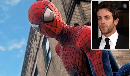

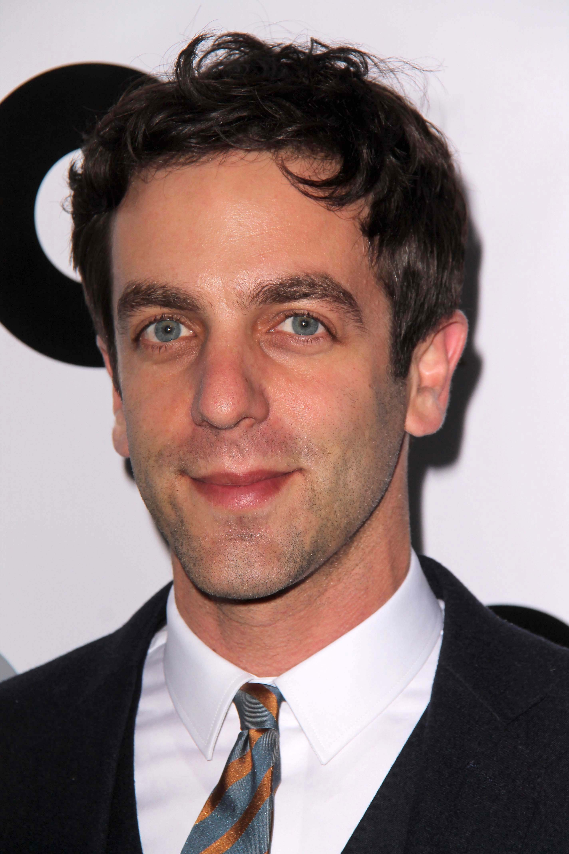

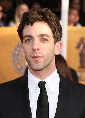

...

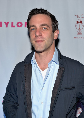

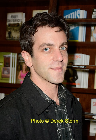

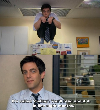

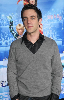

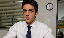

Ben_Stiller


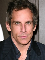

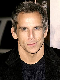

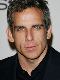

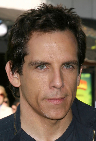

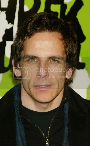

...

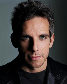

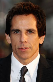

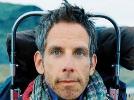

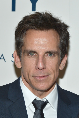

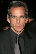

Zooey_Deschanel


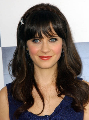

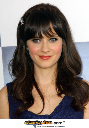

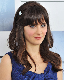

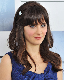

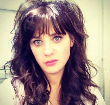

...

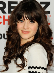

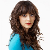

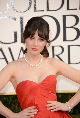

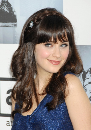

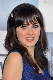

Katy_Perry


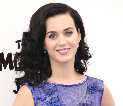

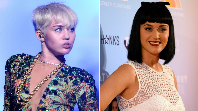

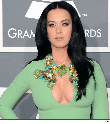

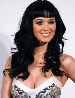

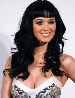

...

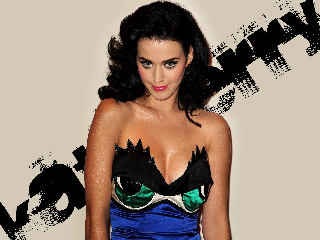

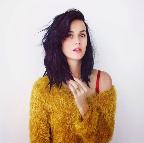

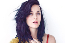

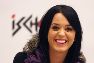

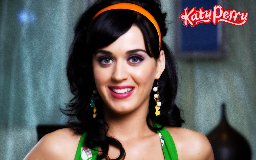

In [ ]:
images = []

for subject in all_subjects[:number_of_subjects]:
  print(subject)

  with open(os.path.join(base_path, "vgg_face_dataset", "files", subject + '.txt'), 'r') as f:
    lines = f.readlines()

  images_ = []
  for line in lines:
    url = line[line.find("http://"): line.find(".jpg") + 4]

    try:
      # Since some images are no longer available, specifying a timeout is useful.
      res = request.urlopen(url=url, timeout=5)
      img = np.asarray(bytearray(res.read()), dtype="uint8")
      img = cv2.imdecode(img, cv2.IMREAD_COLOR)
      h, w = img.shape[:2]
      images_.append(img)
      cv2_imshow(cv2.resize(img, (w // 5, h // 5)))

    except:
      pass

    if len(images_) == number_of_images_per_subject:
      images.append(images_)
      break

## Filter the images

After manual review, I noticed that some images have multiple people in them, this needs to be taken care of.

Therefore I will remove all of the images in which the face count is not equal to 1 and place them into a new list.

Found 1 face(s)!


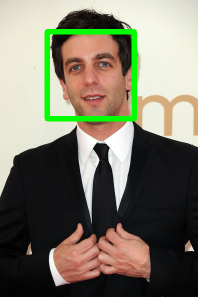

Found 1 face(s)!


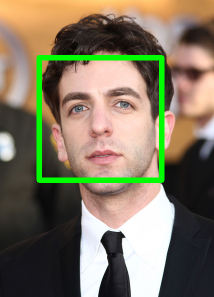

Found 1 face(s)!


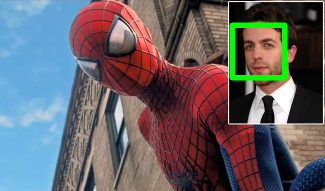

Found 1 face(s)!


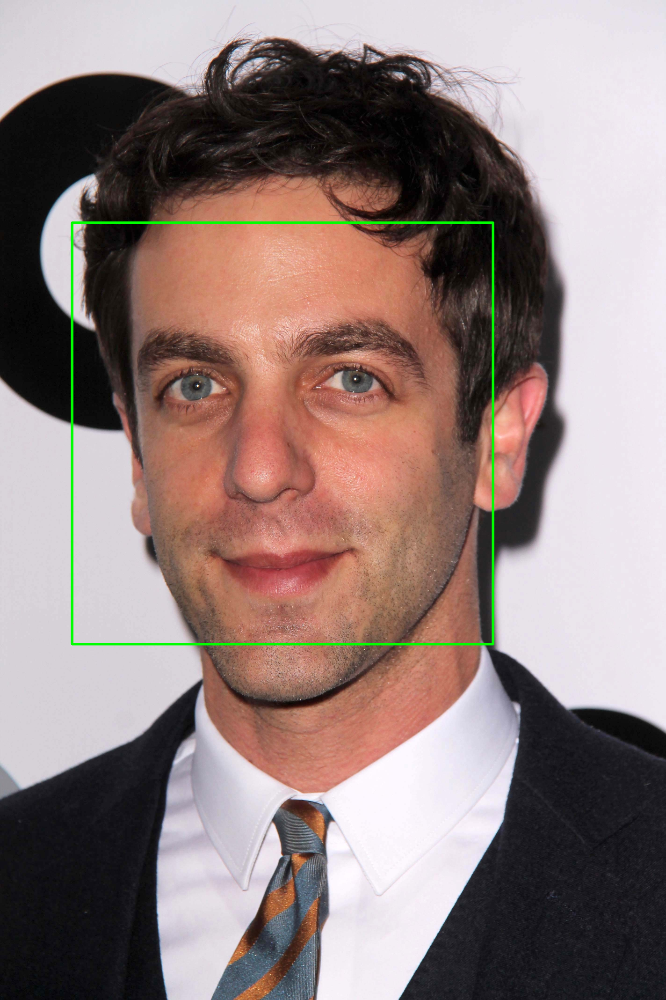

Found 1 face(s)!


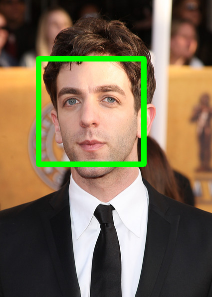

Found 1 face(s)!


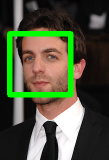

Found 1 face(s)!


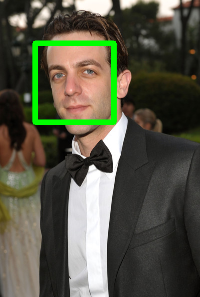

Found 1 face(s)!


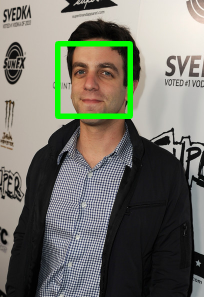

Found 1 face(s)!


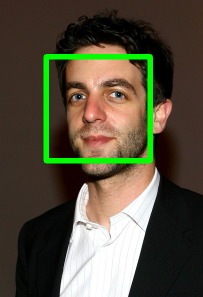

Found 1 face(s)!


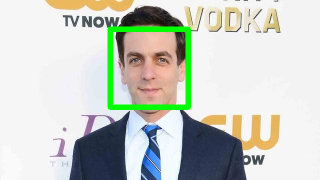

Found 1 face(s)!


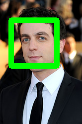

Found 1 face(s)!


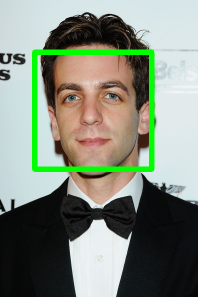

Found 1 face(s)!


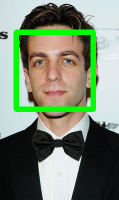

Found 1 face(s)!


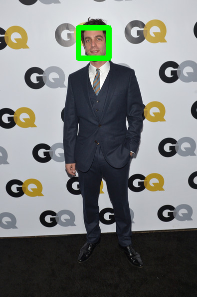

Found 1 face(s)!


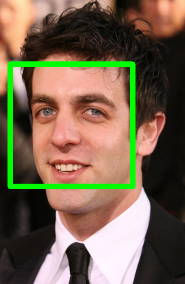

Found 1 face(s)!


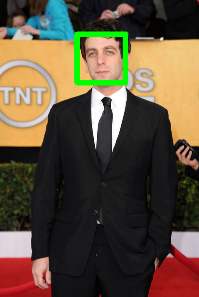

Found 1 face(s)!


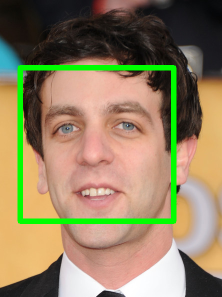

Found 1 face(s)!


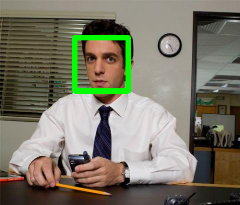

Found 1 face(s)!


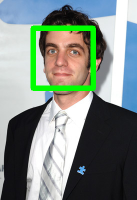

Found 1 face(s)!


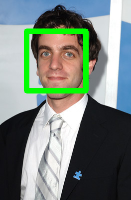

Found 1 face(s)!


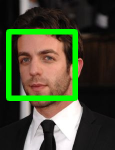

Found 1 face(s)!


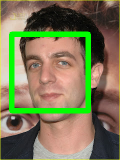

Found 1 face(s)!


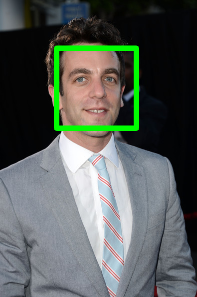

Found 1 face(s)!


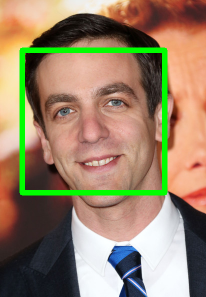

Found 1 face(s)!


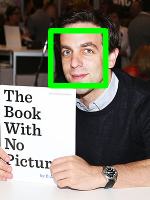

Found 1 face(s)!


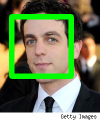

Found 1 face(s)!


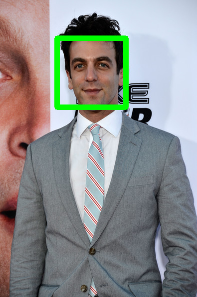

Found 1 face(s)!


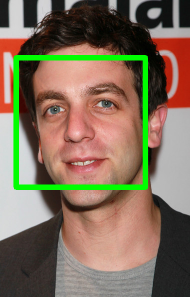

Found 1 face(s)!


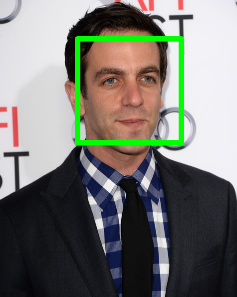

Found 1 face(s)!


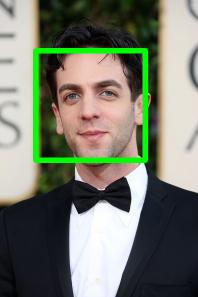

Found 1 face(s)!


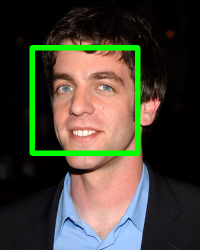

Found 1 face(s)!


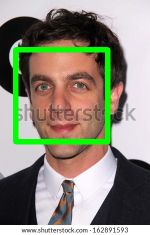

Found 1 face(s)!


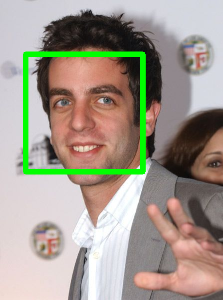

Found 1 face(s)!


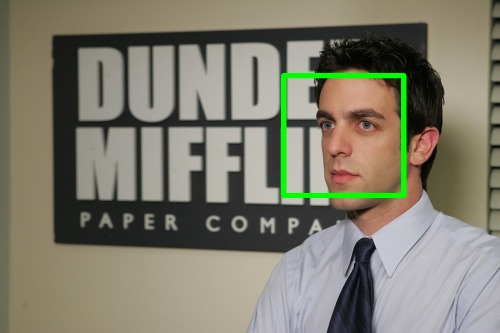

Found 1 face(s)!


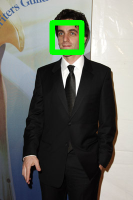

Found 1 face(s)!


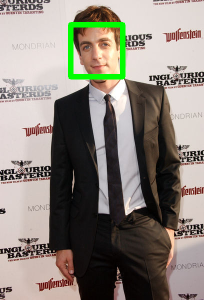

Found 1 face(s)!


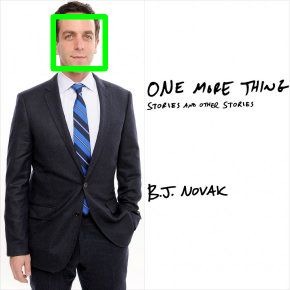

Found 1 face(s)!


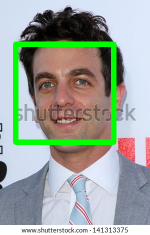

Found 1 face(s)!


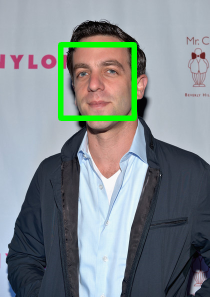

Found 1 face(s)!


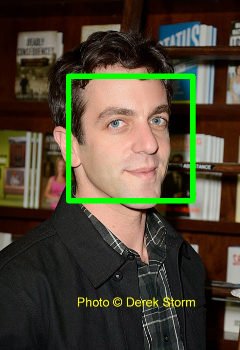

Found 1 face(s)!


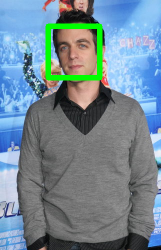

Found 1 face(s)!


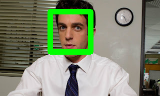

Found 1 face(s)!


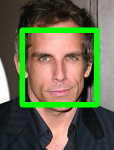

Found 1 face(s)!


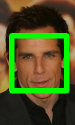

Found 1 face(s)!


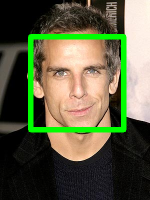

Found 1 face(s)!


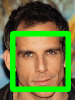

Found 1 face(s)!


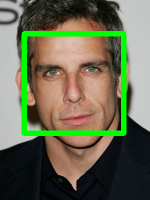

Found 1 face(s)!


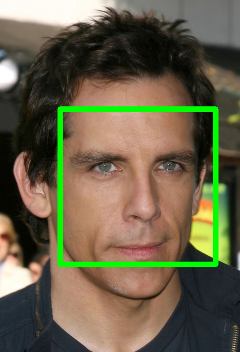

Found 1 face(s)!


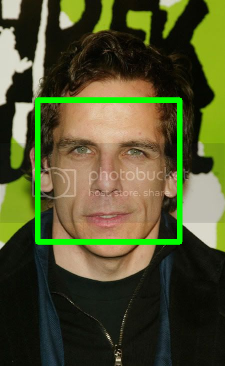

Found 1 face(s)!


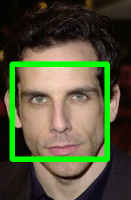

Found 1 face(s)!


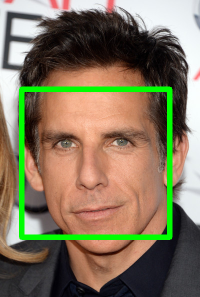

Found 1 face(s)!


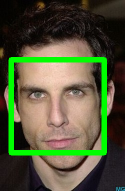

Found 1 face(s)!


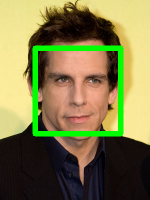

Found 1 face(s)!


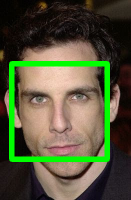

Found 1 face(s)!


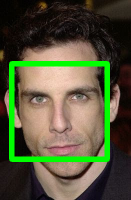

Found 1 face(s)!


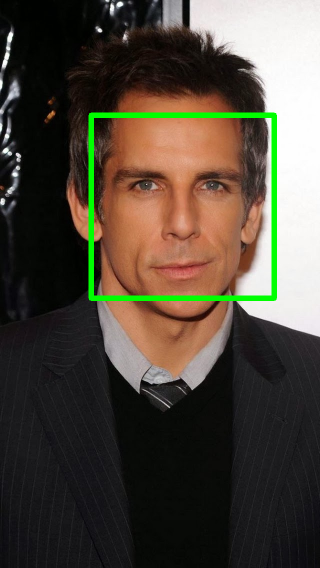

Found 1 face(s)!


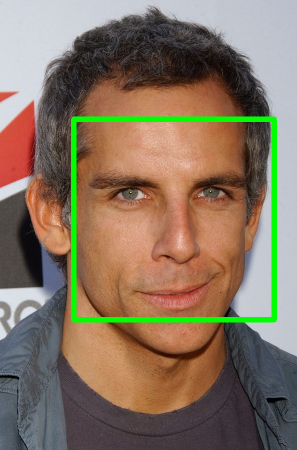

Found 1 face(s)!


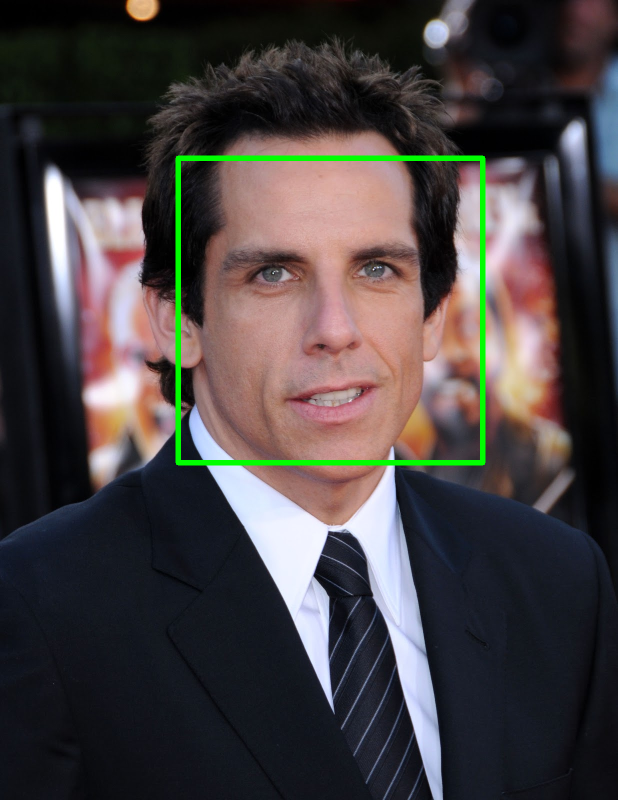

Found 1 face(s)!


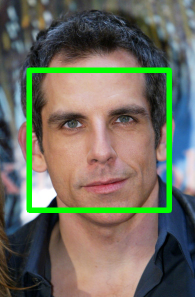

Found 1 face(s)!


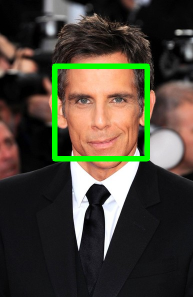

Found 1 face(s)!


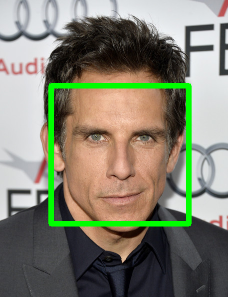

Found 1 face(s)!


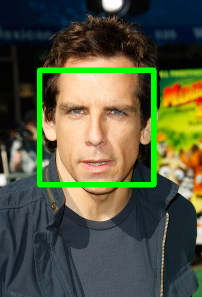

Found 1 face(s)!


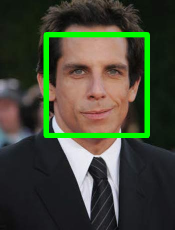

Found 1 face(s)!


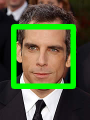

Found 1 face(s)!


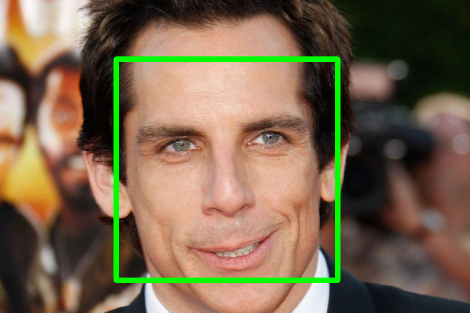

Found 1 face(s)!


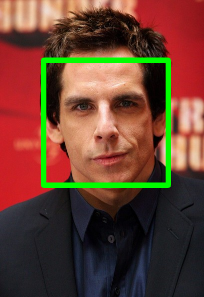

Found 1 face(s)!


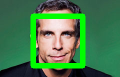

Found 1 face(s)!


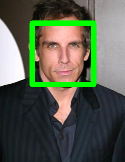

Found 1 face(s)!


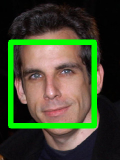

Found 1 face(s)!


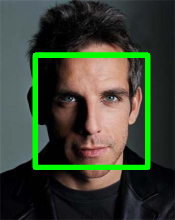

Found 1 face(s)!


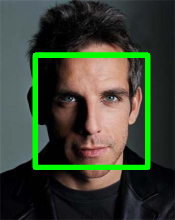

Found 1 face(s)!


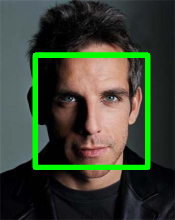

Found 1 face(s)!


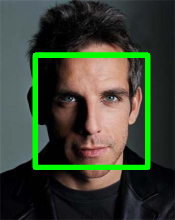

Found 1 face(s)!


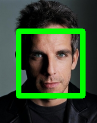

Found 1 face(s)!


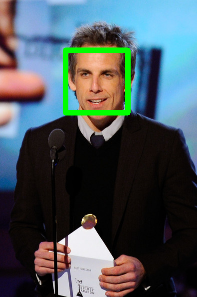

Found 1 face(s)!


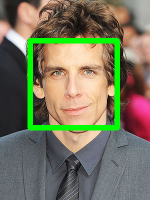

Found 1 face(s)!


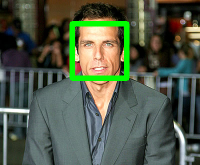

Found 1 face(s)!


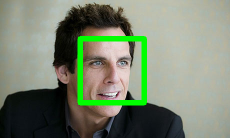

Found 1 face(s)!


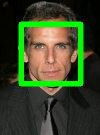

Found 1 face(s)!


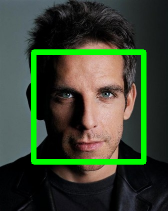

Found 1 face(s)!


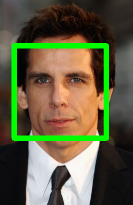

Found 1 face(s)!


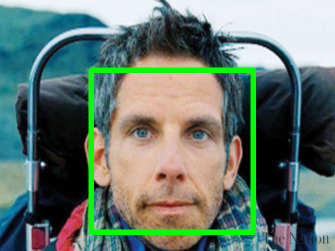

Found 1 face(s)!


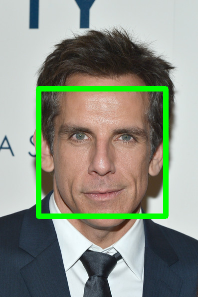

Found 1 face(s)!


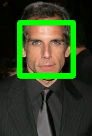

Found 1 face(s)!


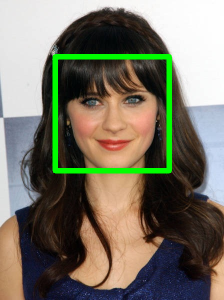

Found 1 face(s)!


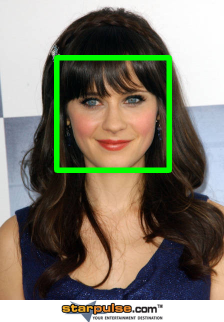

Found 1 face(s)!


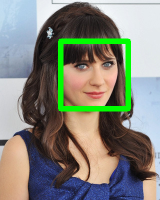

Found 1 face(s)!


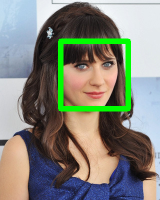

Found 1 face(s)!


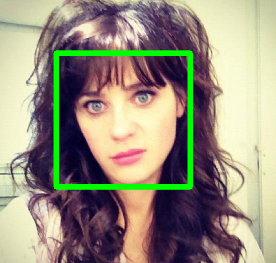

Found 1 face(s)!


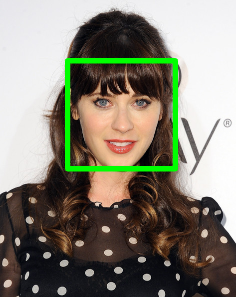

Found 1 face(s)!


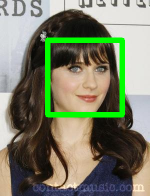

Found 1 face(s)!


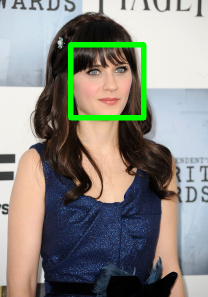

Found 1 face(s)!


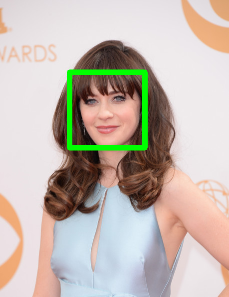

Found 1 face(s)!


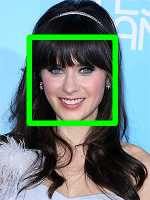

Found 1 face(s)!


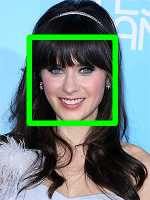

Found 1 face(s)!


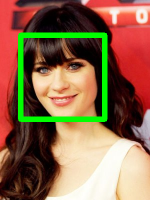

Found 1 face(s)!


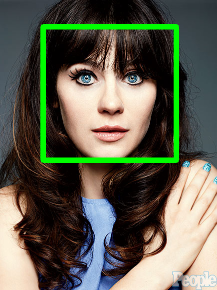

Found 1 face(s)!


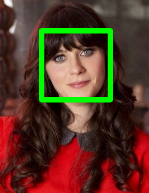

Found 1 face(s)!


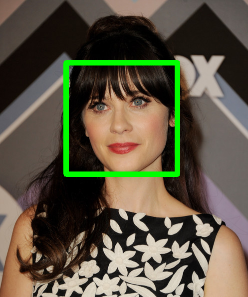

Found 1 face(s)!


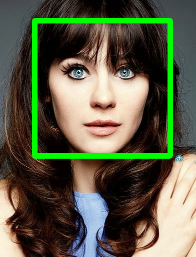

Found 1 face(s)!


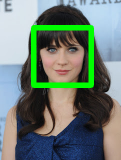

Found 1 face(s)!


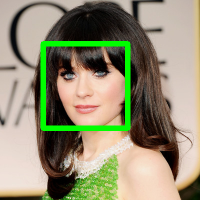

Found 1 face(s)!


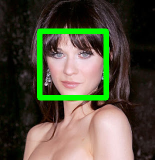

Found 1 face(s)!


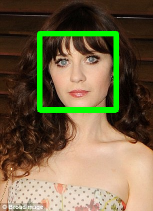

Found 1 face(s)!


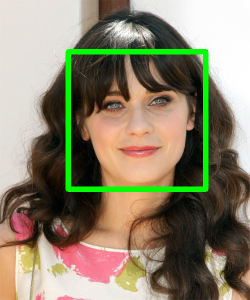

Found 1 face(s)!


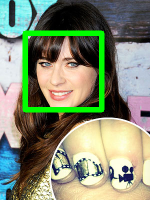

Found 1 face(s)!


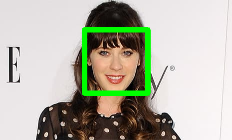

Found 1 face(s)!


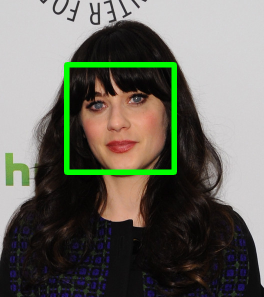

Found 1 face(s)!


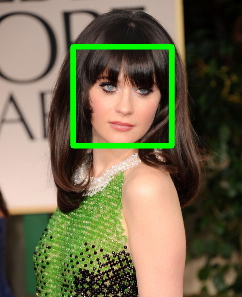

Found 1 face(s)!


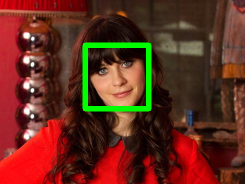

Found 1 face(s)!


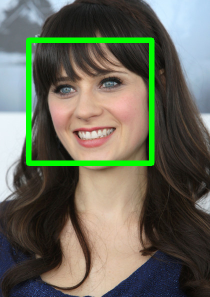

Found 1 face(s)!


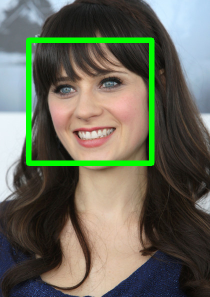

Found 1 face(s)!


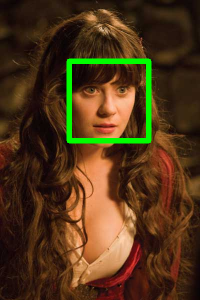

Found 1 face(s)!


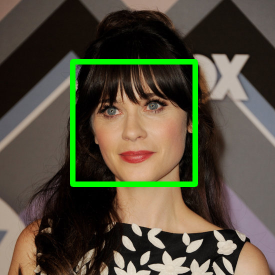

Found 1 face(s)!


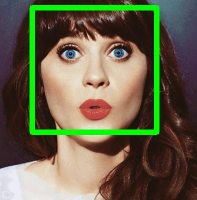

Found 1 face(s)!


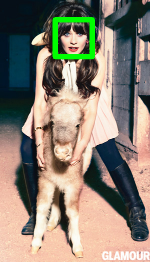

Found 1 face(s)!


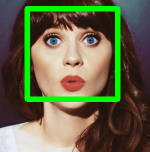

Found 1 face(s)!


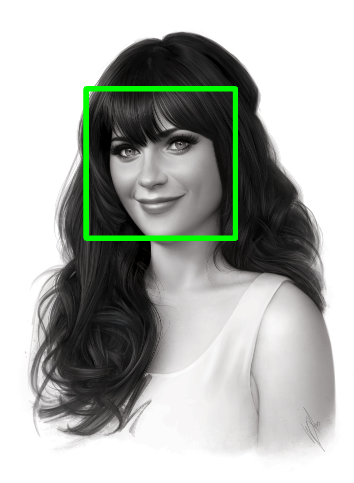

Found 1 face(s)!


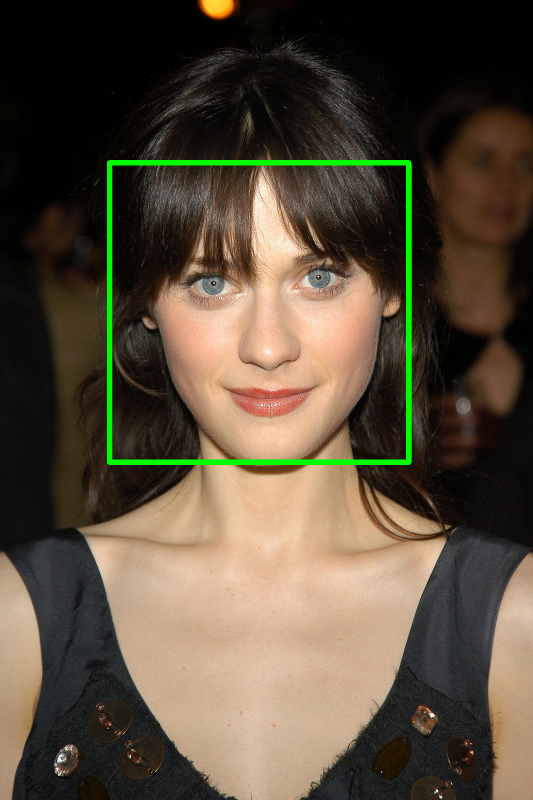

Found 1 face(s)!


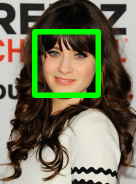

Found 1 face(s)!


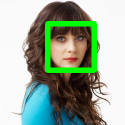

Found 1 face(s)!


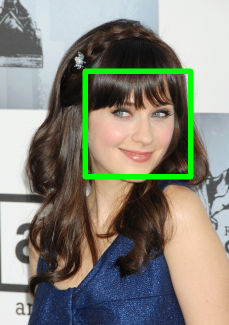

Found 1 face(s)!


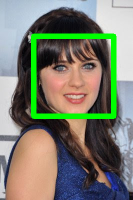

Found 1 face(s)!


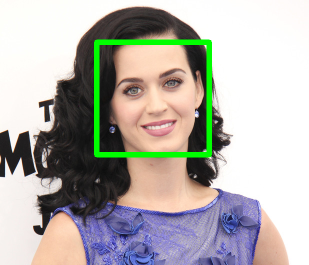

Found 1 face(s)!


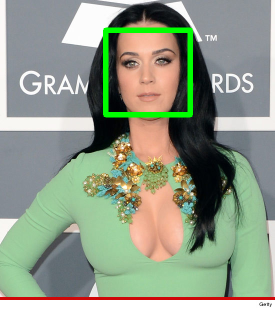

Found 1 face(s)!


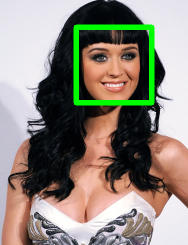

Found 1 face(s)!


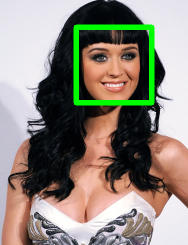

Found 1 face(s)!


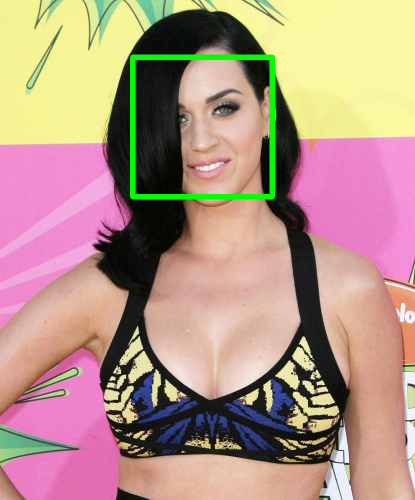

Found 1 face(s)!


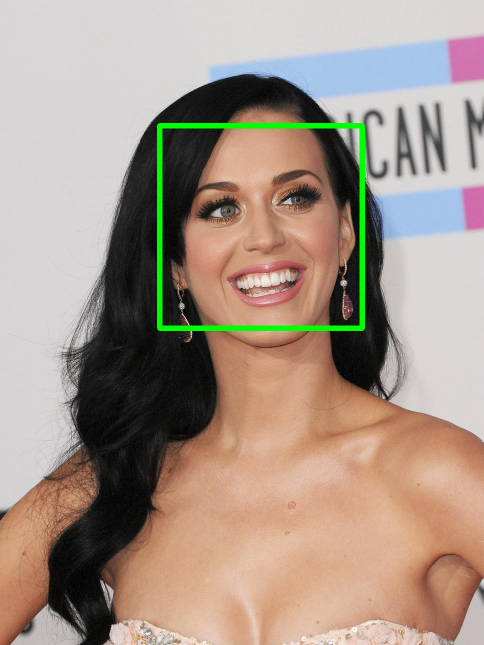

Found 1 face(s)!


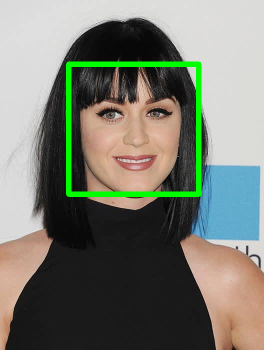

Found 1 face(s)!


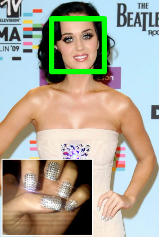

Found 1 face(s)!


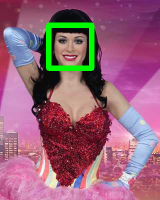

Found 1 face(s)!


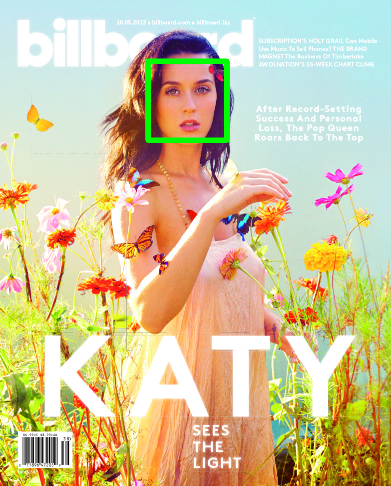

Found 1 face(s)!


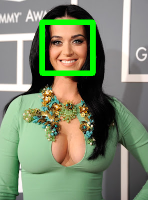

Found 1 face(s)!


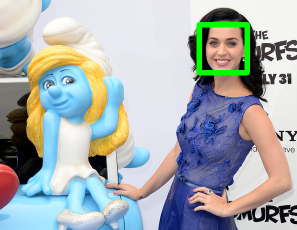

Found 1 face(s)!


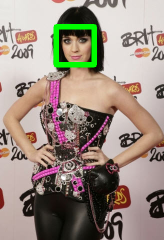

Found 1 face(s)!


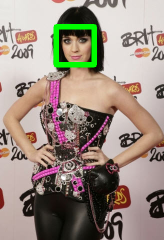

Found 1 face(s)!


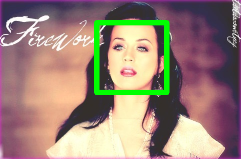

Found 1 face(s)!


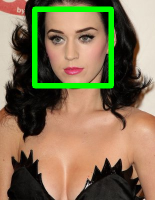

Found 1 face(s)!


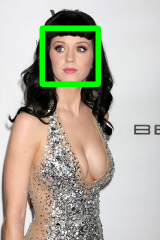

Found 1 face(s)!


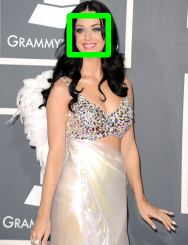

Found 1 face(s)!


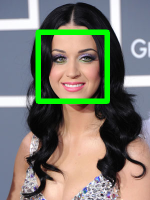

Found 1 face(s)!


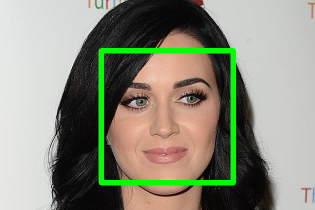

Found 1 face(s)!


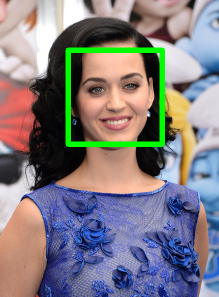

Found 1 face(s)!


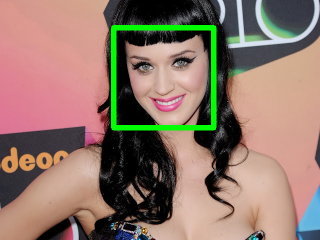

Found 1 face(s)!


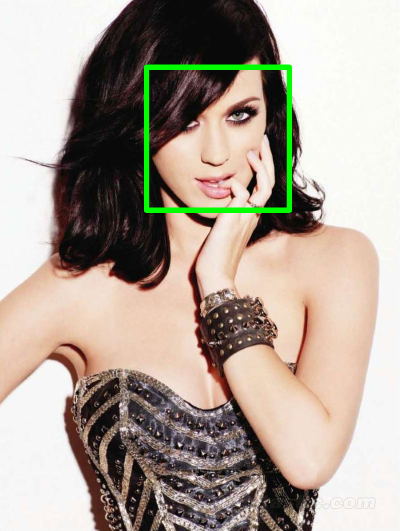

Found 1 face(s)!


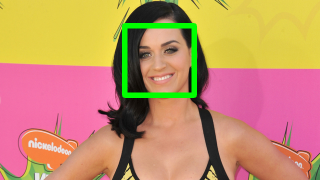

Found 1 face(s)!


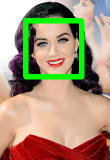

Found 1 face(s)!


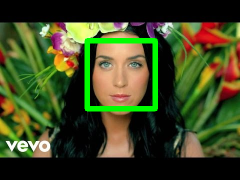

Found 1 face(s)!


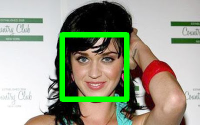

Found 1 face(s)!


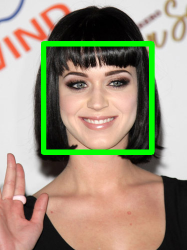

Found 1 face(s)!


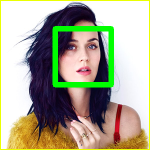

Found 1 face(s)!


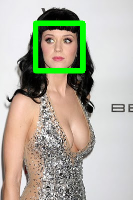

Found 1 face(s)!


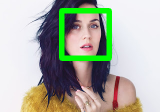

Found 1 face(s)!


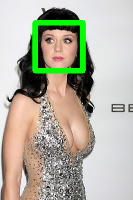

Found 1 face(s)!


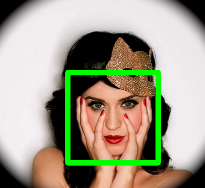

Found 1 face(s)!


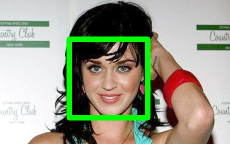

Found 1 face(s)!


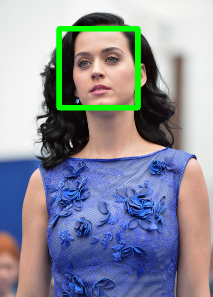

Found 1 face(s)!


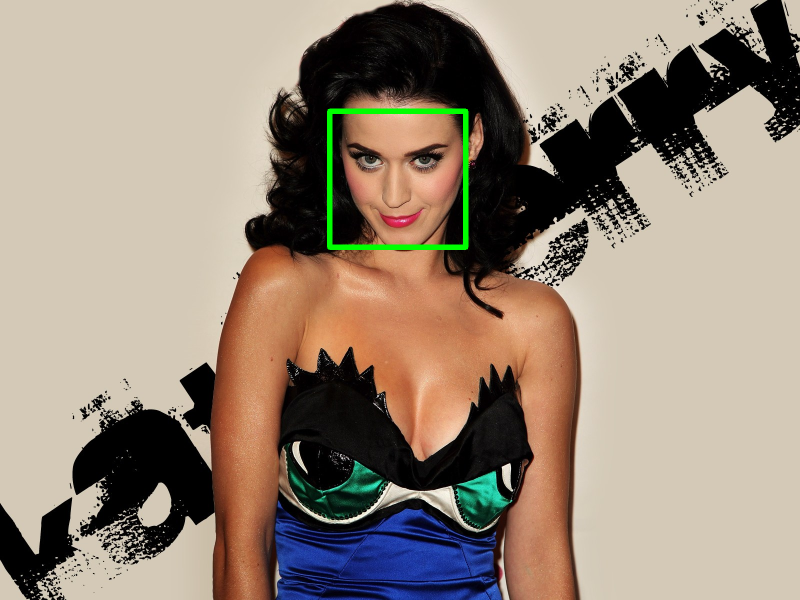

Found 1 face(s)!


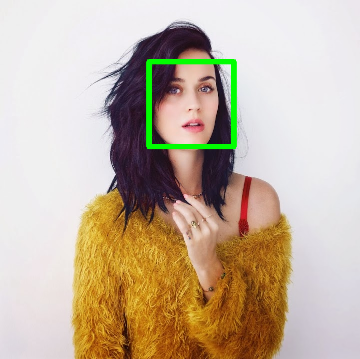

Found 1 face(s)!


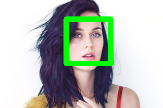

Found 1 face(s)!


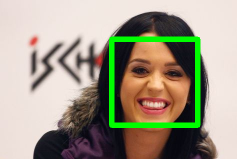

Found 1 face(s)!


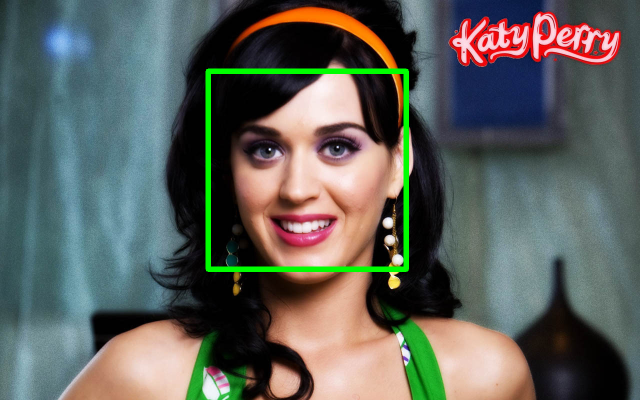

In [ ]:
faceCascade = cv2.CascadeClassifier(os.path.join(base_path, "haarcascade_frontalface_default.xml"))

filtered_images = []
removed_images = 0

scale_percent = 50 # percent of original size

for i, images_ in enumerate(images):

  filtered_images_ = []

  for j, img in enumerate(images_):
    
    image = img.copy()

    img_ = img.copy()
    img_gray = cv2.cvtColor(img_, cv2.COLOR_BGR2GRAY)
    faces = faceCascade.detectMultiScale(
        img_gray,
        scaleFactor=1.2,
        minNeighbors=5,
        minSize=(30, 30),
        flags=cv2.CASCADE_SCALE_IMAGE
    )

    # If there are multiple faces in an image, I will skip the iteration and increase the counter.
    if len(faces) != 1:
      removed_images += 1
      
      # After the counter has been increased, we skip the iteration.
      # (the image is not added to the 'filtered_image' list)
      continue

    print("Found {} face(s)!".format(len(faces)))

    for (x, y, w, h) in faces:
        cv2.rectangle(img_, (x, y), (x+w, y+h), (0, 255, 0), 10)

    width = int(img_.shape[1] * scale_percent / 100)
    height = int(img_.shape[0] * scale_percent / 100)    

    dimensions = (width, height)

    cv2_imshow(cv2.resize(img_, dimensions))

    # Since an image only contains one face, it's being added to the 'filtered_image' list.
    # The images are also converted to 224 by 224 size, since the VGG16 model, which we will be using, requires this.
    filtered_images_.append(cv2.resize(image, (224, 224)))

  filtered_images.append(filtered_images_)

## **Removing duplicates**

I noticed that some of the images that I retrieved from the files are duplicates.  
Sometimes it's an exact copy, sometimes they are cropped slightly differently and sometimes they have different colors, therefore a pixel by pixel array comparison wouldn't work.  

Since I thought that duplicate images wouldn't be beneficial to training the model, I decided to remove these duplicates.

And I did it by making use of a package called ['imagehash'](https://pypi.org/project/ImageHash/)


### **What is 'imagehash' ?**
ImageHash is a library written in python, which uses an algorithm to assign a unique hash value to an image.

Unlike cryptographic hashing algorithms, tiny changes to the image don't give a completely different hash, and this is extremely useful in scenarios like this, where we want to find duplicates and remove them.

The image hash algorithms (average, perceptual, difference, wavelet) analyse the image structure on luminance (without color information).


### **How do I do it ?**
In order to accomplish my goal, I loop through the image list and compare each image to all other images.  

But since removing elements from an array while looping through it would cause issues to the consuquent iterations, for the duplicate image I reverse the list and loop from the back to the start. 

With this approach, no issues will arise if elements are removed, since the elements beyond that point will never be accessed again.



Primary Image



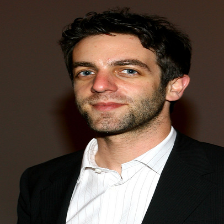



Duplicate Image



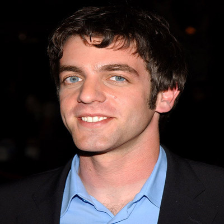



Primary Image



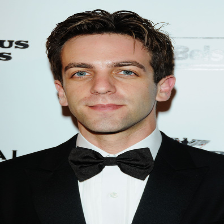



Duplicate Image



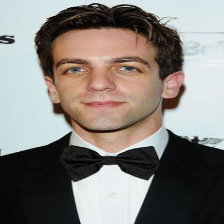



Primary Image



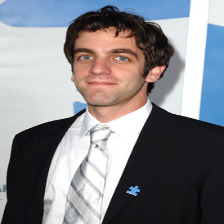



Duplicate Image



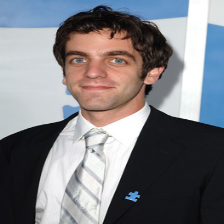



Primary Image



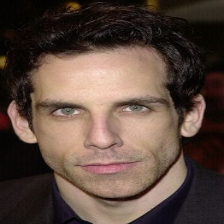



Duplicate Image



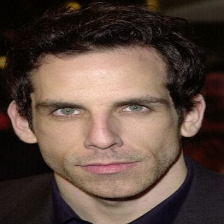



Primary Image



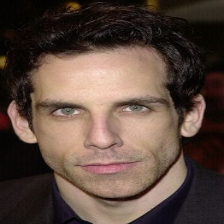



Duplicate Image



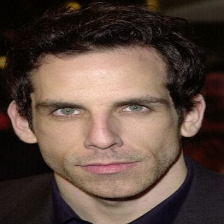



Primary Image



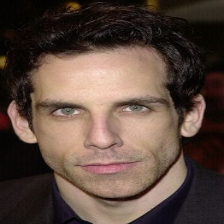



Duplicate Image



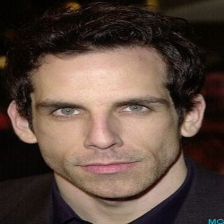



Primary Image



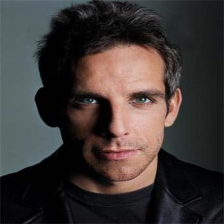



Duplicate Image



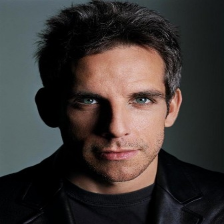



Primary Image



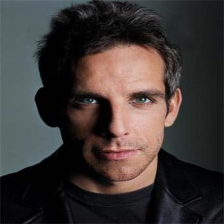



Duplicate Image



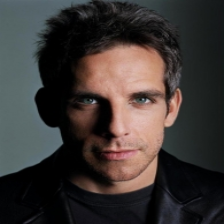



Primary Image



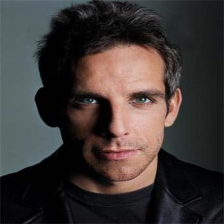



Duplicate Image



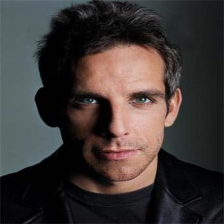



Primary Image



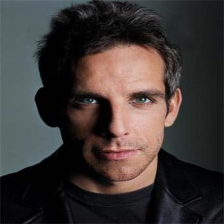



Duplicate Image



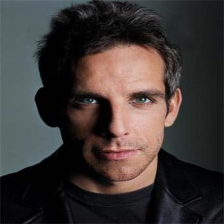



Primary Image



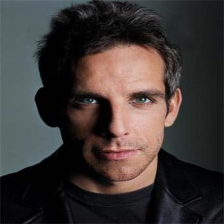



Duplicate Image



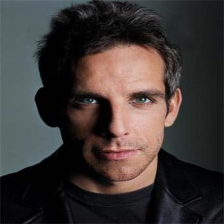



Primary Image



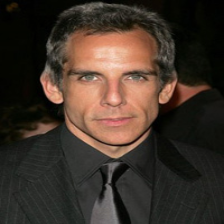



Duplicate Image



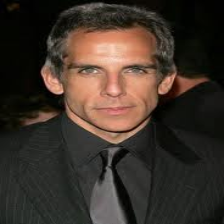



Primary Image



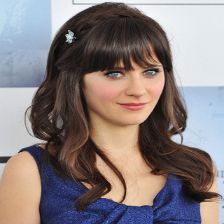



Duplicate Image



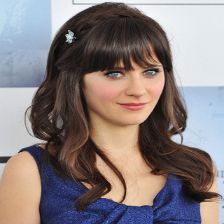



Primary Image



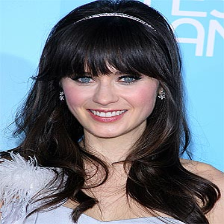



Duplicate Image



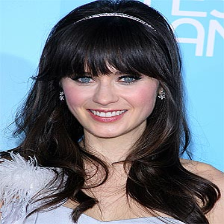



Primary Image



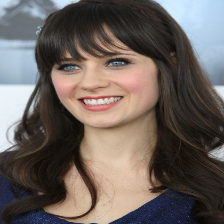



Duplicate Image



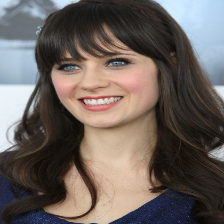



Primary Image



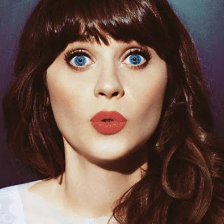



Duplicate Image



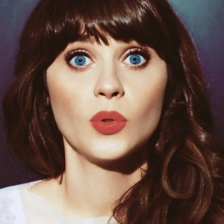



Primary Image



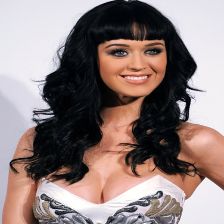



Duplicate Image



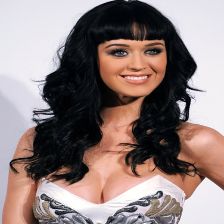



Primary Image



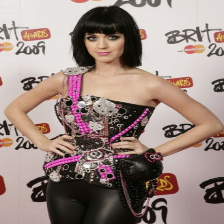



Duplicate Image



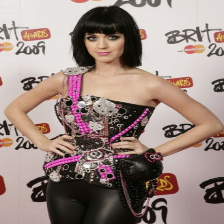



Primary Image



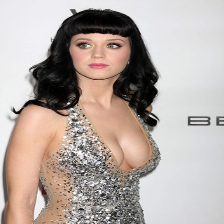



Duplicate Image



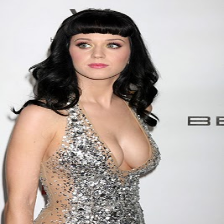



Primary Image



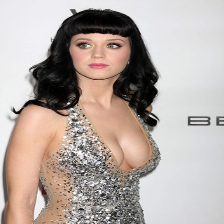



Duplicate Image



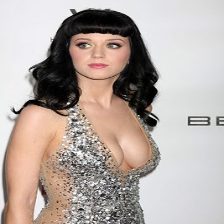



Primary Image



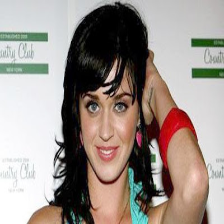



Duplicate Image



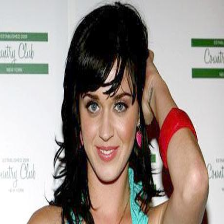



Primary Image



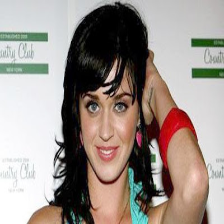



Duplicate Image



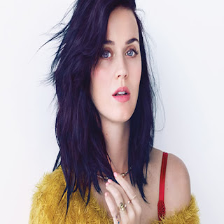

Total number of images removed: 22


In [ ]:
removed_images_count = 0
cutoff = 6

for i, images_ in enumerate(filtered_images):

  for j, img1 in enumerate(images_):
    primary_image = Image.fromarray(filtered_images[i][j], 'RGB')
    primary_image_hash = imagehash.average_hash(primary_image) 

    for k, img2 in reversed(list(enumerate(images_))):

      if j != k:
        duplicate_image = Image.fromarray(filtered_images[i][k], 'RGB')
        duplicate_image_hash = imagehash.average_hash(duplicate_image)


        if primary_image_hash - duplicate_image_hash < cutoff:

          print('\n\nPrimary Image\n')
          cv2_imshow(filtered_images[i][j])

          print('\n\nDuplicate Image\n')
          cv2_imshow(filtered_images[i][k])

          removed_images_count += 1
          filtered_images[i].pop(k)

print('Total number of images removed: {}'.format(removed_images_count))

## Final result

In [ ]:
# B.J. Novak
bj_novak_images = []
bj_novak_labels = []

# Ben Stiller
ben_stiller_images = []
ben_stiller_labels = []

# Zooey Deschanel
zooey_deschanel_images = []
zooey_deschanel_labels = []

# Katy Perry
katy_perry_images = []
katy_perry_labels = []

# Notes, within the images list the order is: ['B.J._Novak', 'Ben_Stiller', 'Zooey_Deschanel', 'Katy_Perry'].

for i, filtered_images_ in enumerate(filtered_images):
  for j, img in enumerate(filtered_images_):

      # Only add 30 images
      if (i == 1 or i == 2) and j == 30:
        break
      elif (i == 0 or i == 3) and j == 10:
        break

      if i == 0:
        bj_novak_images.append(cv2.resize(img, (224, 224)))
        bj_novak_labels.append(all_subjects[0])
      elif i == 1:
        ben_stiller_images.append(cv2.resize(img, (224, 224)))
        ben_stiller_labels.append(all_subjects[1])
      elif i == 2:
        zooey_deschanel_images.append(cv2.resize(img, (224, 224)))
        zooey_deschanel_labels.append(all_subjects[2])
      else:
        katy_perry_images.append(cv2.resize(img, (224, 224)))
        katy_perry_labels.append(all_subjects[3])

## Splitting the collected images into training and testing sets

![image_specs](https://drive.google.com/uc?export=view&id=1PgdJrnxX9VrnAHe_vDXPGSKhDU0BB36Y)

For this step, we will not overcomplicate things and will simply divide the images based on index.



In [ ]:
# Train
x_train = np.concatenate((zooey_deschanel_images[:20], ben_stiller_images[:20]))
y_train = np.concatenate((zooey_deschanel_labels[:20], ben_stiller_labels[:20]))

x_test = np.concatenate((zooey_deschanel_images[20:30], ben_stiller_images[20:30]))
y_test = np.concatenate((zooey_deschanel_labels[20:30], ben_stiller_labels[20:30]))

print('x_train: {}'.format(x_train.shape))
print('y_train: {}'.format(y_train.shape))
print()
print('x_test: {}'.format(x_test.shape))
print('y_test: {}'.format(y_test.shape))

x_train: (40, 224, 224, 3)
y_train: (40,)

x_test: (20, 224, 224, 3)
y_test: (20,)


## Encoding labels

The model can't be fitted with Target values of type String, therefore we have to encode them.

In [ ]:
le = LabelEncoder()
y_train_encoded = le.fit_transform(y_train)

In [ ]:
print(le.classes_)
y_test_encoded = le.transform(y_test)

['Ben_Stiller' 'Zooey_Deschanel']


In [ ]:
print('y_train_encoded : ', y_train_encoded)
print('y_test_encoded : ', y_test_encoded)

y_train_encoded :  [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0]
y_test_encoded :  [1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0]


## Creating the model

The model which we will use is VGG16.

![vgg16](https://neurohive.io/wp-content/uploads/2018/11/vgg16-1-e1542731207177.png)

### What is VGG16 ?

VGG16 is a convolutional neural network model proposed by K. Simonyan and A. Zisserman from the University of Oxford in the paper “Very Deep Convolutional Networks for Large-Scale Image Recognition”.   

The model achieves 92.7% top-5 test accuracy in ImageNet, which is a dataset of over 14 million images belonging to 1000 classes.

Although for our usecase, we will not make use of the imagenet classes and weights.

And instead of using 'softmax' for the output layer, we will be using 'sigmoid', since we only have two classes, which qualify for a two-class logistic regression.  

(The **sigmoid** function is used for the two-class logistic regression, whereas the **softmax** function is used for the multiclass logistic regression)

In [ ]:
def vgg_model():	
  model = tf.keras.applications.VGG16(include_top=False, input_shape=(224, 224, 3))

  for layer in model.layers:
    layer.trainable = False

  x = Flatten()(model.output)
  x = Dense(1, activation = 'sigmoid')(x)

  model = tf.keras.Model(inputs = model.input, outputs = x)

  return model

In [ ]:
vgg16_model = vgg_model()

58889256/58889256 [==============================] - 2s 0us/step


In [ ]:
vgg16_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [ ]:
vgg16_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

## Fitting the model

For the model, we will use [early stopping](https://keras.io/api/callbacks/early_stopping/) to make sure we end up with the best weights possible for our model.

We will be training the model for 50 epochs and if the loss doesn't decrease in 5 epochs time, we end the training and pick the best result.

In [ ]:
early_stopping = EarlyStopping(monitor='loss', mode='min', patience=5, restore_best_weights=True)

vgg16_model.fit(np.array(x_train), np.array(y_train_encoded), epochs=100, batch_size=32, callbacks=[early_stopping])

Epoch 1/100
2/2 [==============================] - 13s 1s/step - loss: 3.3643 - accuracy: 0.5500
Epoch 2/100
2/2 [==============================] - 0s 101ms/step - loss: 7.2017e-12 - accuracy: 1.0000
Epoch 3/100
2/2 [==============================] - 0s 96ms/step - loss: 4.8310e-15 - accuracy: 1.0000
Epoch 4/100
2/2 [==============================] - 0s 95ms/step - loss: 4.9085e-17 - accuracy: 1.0000
Epoch 5/100
2/2 [==============================] - 0s 100ms/step - loss: 1.4967e-18 - accuracy: 1.0000
Epoch 6/100
2/2 [==============================] - 0s 106ms/step - loss: 9.5928e-20 - accuracy: 1.0000
Epoch 7/100
2/2 [==============================] - 0s 107ms/step - loss: 1.0576e-20 - accuracy: 1.0000
Epoch 8/100
2/2 [==============================] - 0s 99ms/step - loss: 8.1708e-22 - accuracy: 1.0000
Epoch 9/100
2/2 [==============================] - 0s 100ms/step - loss: 4.0684e-22 - accuracy: 1.0000
Epoch 10/100
2/2 [==============================] - 0s 102ms/step - loss: 7.2193e-

## Results of the model

The results shown are in a range from 0 to 1.  

![range](https://i.imgur.com/CMw2qHP.png)

The meaning behind this range is that, the closer it is either to 0 or 1, the higher the confidence in the prediction.

In our case 0 represents Zoey Deschanel and 1 represents Ben Stiller.

In [ ]:
n_rows = 5
n_cols = 4

### Results for Person A and Person B

These results are for the people we trained or model on.

In [ ]:
results_1 = vgg16_model.predict(x_test)

1/1 [==============================] - 2s 2s/step


In [ ]:
print(results_1)

[[1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [5.6927802e-26]
 [1.5076317e-33]
 [9.2117591e-32]
 [2.4629713e-20]
 [1.0000000e+00]
 [0.0000000e+00]
 [9.3575783e-31]
 [1.4966200e-16]
 [4.2403021e-28]]


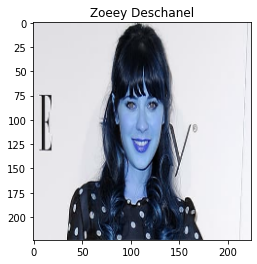

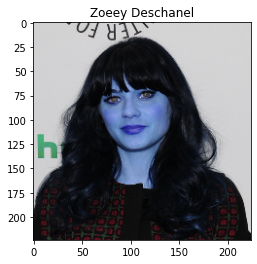

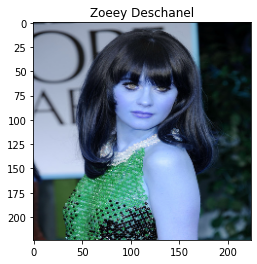

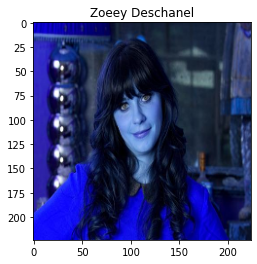

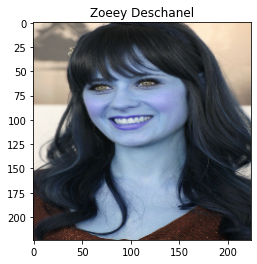

...

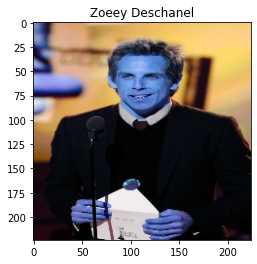

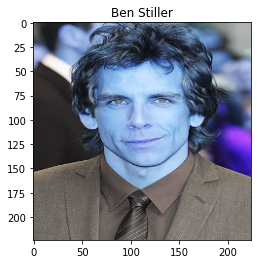

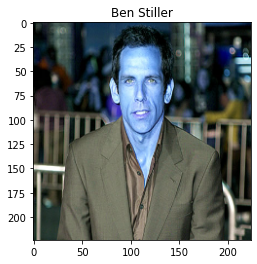

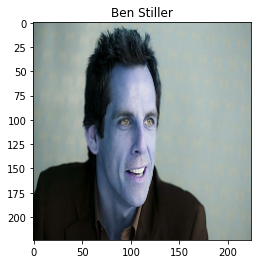

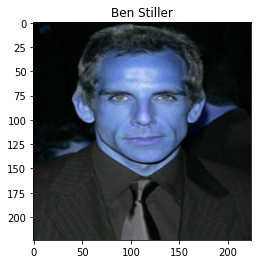

In [25]:
for index, result in enumerate(results_1):
  person_label = ''

  if result < 0.5:
    person_label = 'Ben Stiller'
  else:
    person_label = 'Zoeey Deschanel'

  im = Image.fromarray(np.uint8(x_test[index]))
  plt.imshow(im)
  plt.title(person_label)
  plt.show()

### Results for Person C and Person D

These results are for the similar person images.

In [26]:
x_test_2 = np.concatenate((bj_novak_images[:10], katy_perry_images[:10]))

print('x_test_2: {}'.format(x_test_2.shape))

x_test_2: (20, 224, 224, 3)


In [27]:
results_2 = vgg16_model.predict(x_test_2)

print(results_2)

1/1 [==============================] - 0s 20ms/step
[[2.8650215e-08]
 [0.0000000e+00]
 [1.0000000e+00]
 [0.0000000e+00]
 [0.0000000e+00]
 [5.5393940e-27]
 [1.2734483e-25]
 [1.9819945e-06]
 [1.1427327e-23]
 [4.2780624e-03]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]
 [1.0000000e+00]]


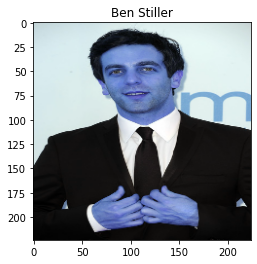

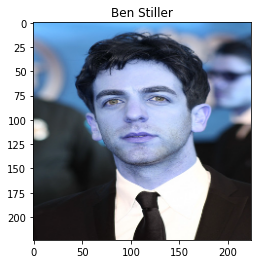

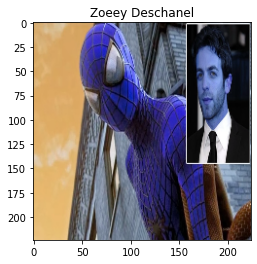

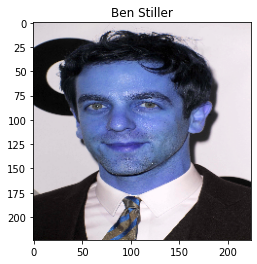

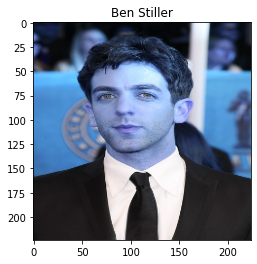

...

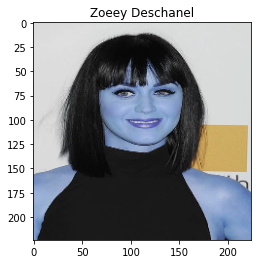

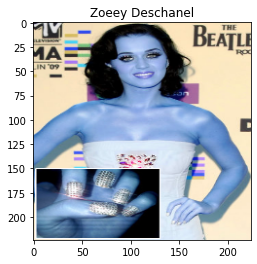

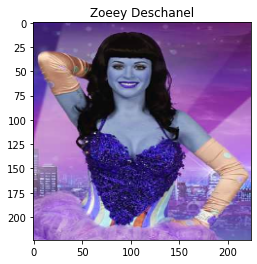

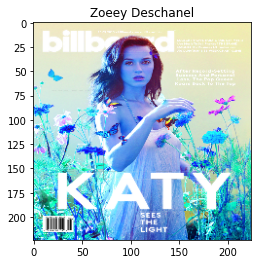

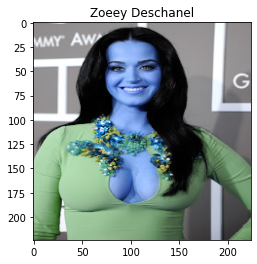

In [28]:
for index, result in enumerate(results_2):
  person_label = ''

  if result < 0.5:
    person_label = 'Ben Stiller'
  else:
    person_label = 'Zoeey Deschanel'
    
  im = Image.fromarray(np.uint8(x_test_2[index]))
  plt.imshow(im)
  plt.title(person_label)
  plt.show()

## Conclusion

The model seems to perform really well, and the probability of the results is also showing high results, which means that the model is very confident in it's prediction.  

As for the possible improvements, since my accuracy was 100%, there's not much neccessity to make any improvements at the moment.

But I'm certain that if the images had more variation to them, like:
- Side pictures
- Different outfits
- Different backgrounds
- Different hairstyles

Then I would have to supply more images for the training set, cause with only 20 images, the same kind of accuracy would be impossible to achieve.

I also would have liked to do a multi-class regression, so that I could try it out with more people (more classes), and also more varying images, but maybe we will be able to do this at a later state.


Thank you for your attention, hopefully it was understandable.